# Intelligent Player Scouting and Talent Acquisition for Football Managers using AI

With the use of the FIFA19 dataset, the proposed AI model solves the difficulties managers have while attempting to choose the best players, as well as identifying the average, underperforming, undervalued, and overpriced players.


**The structure of the model is described in two phases:**

The first phase is to effectively build a model capable of grouping players based on their similarity in traits. To do this, I have implemented K-means, K-means++ and DBSCAN algorithms to group players based on their individual abilities, as well as noise removal from the dataset. The model can potentially identify patterns those certain players share in ways that would not normally have been considered by the team managers during their manual evaluation.

The second phase entails building a classification model that will be capable of re-evaluating the players based on the cluster labels provided by the clustering algorithm in the first phase. These classifiers will be able to predict what group a fresh set of players will belong to. Support Vector Machine and Random Forest are two ML algorithms that I used for this. This would also help managers diagnose lack of skill diversity, identify under-priced and over-priced players, and potentially influence their transfer decisions.



### Importing all of the libraries required to build the model

In [1]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt

In [2]:
from sklearn.preprocessing import scale
from sklearn import preprocessing
import itertools
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from sklearn.model_selection import ParameterGrid
from sklearn import metrics
from sklearn.preprocessing import LabelEncoder
import imblearn
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import OneHotEncoder
from sklearn.utils import shuffle
import plotly.graph_objs as go
from itertools import product
from sklearn.neighbors import NearestNeighbors

### About the Dataset

The dataset in use was obtained from Kaggle, which can be accessed online. Please, click on the link to download the dataset. https://www.kaggle.com/karangadiya/fifa19.

In [5]:
data=pd.read_csv("data.csv")
data.head()

,Unnamed: 0,ID,Name,Age,Photo,Nationality,Flag,Overall,Potential,Club,...,Composure,Marking,StandingTackle,SlidingTackle,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes,Release Clause
0,0,158023,L. Messi,31,https://cdn.sofifa.org/players/4/19/158023.png,Argentina,https://cdn.sofifa.org/flags/52.png,94,94,FC Barcelona,...,96.0,33.0,28.0,26.0,6.0,11.0,15.0,14.0,8.0,€226.5M
1,1,20801,Cristiano Ronaldo,33,https://cdn.sofifa.org/players/4/19/20801.png,Portugal,https://cdn.sofifa.org/flags/38.png,94,94,Juventus,...,95.0,28.0,31.0,23.0,7.0,11.0,15.0,14.0,11.0,€127.1M
2,2,190871,Neymar Jr,26,https://cdn.sofifa.org/players/4/19/190871.png,Brazil,https://cdn.sofifa.org/flags/54.png,92,93,Paris Saint-Germain,...,94.0,27.0,24.0,33.0,9.0,9.0,15.0,15.0,11.0,€228.1M
3,3,193080,De Gea,27,https://cdn.sofifa.org/players/4/19/193080.png,Spain,https://cdn.sofifa.org/flags/45.png,91,93,Manchester United,...,68.0,15.0,21.0,13.0,90.0,85.0,87.0,88.0,94.0,€138.6M
4,4,192985,K. De Bruyne,27,https://cdn.sofifa.org/players/4/19/192985.png,Belgium,https://cdn.sofifa.org/flags/7.png,91,92,Manchester City,...,88.0,68.0,58.0,51.0,15.0,13.0,5.0,10.0,13.0,€196.4M


### Dataset contains 18,207 rows and 89 columns

In [6]:
data.shape

(18207, 89)

### Examine the percentage of empty rows also known as NaN (not a number)

In [7]:
train_test = pd.concat([data.drop('Photo', axis = 1)], keys = ['data'], axis = 0)
missing_values = pd.concat([train_test.isna().sum(),
                            (train_test.isna().sum() / train_test.shape[0]) * 100], axis = 1, 
                           keys = ['Values missing', 'Percent of missing'])
missing_values.loc[missing_values['Percent of missing'] > 0].sort_values(ascending = False, by = 'Percent of missing').style.background_gradient('Blues')

,Values missing,Percent of missing
Loaned From,16943,93.057615
CB,2085,11.451639
CM,2085,11.451639
RAM,2085,11.451639
CAM,2085,11.451639
LAM,2085,11.451639
RW,2085,11.451639
RF,2085,11.451639
CF,2085,11.451639
LF,2085,11.451639


### To remove columns that will not be used in the model, I need replace the column identifier ignoring spaces

In [8]:
data.columns = [c.replace(' ', '') for c in data.columns]
data.columns

Index(['Unnamed:0', 'ID', 'Name', 'Age', 'Photo', 'Nationality', 'Flag',
       'Overall', 'Potential', 'Club', 'ClubLogo', 'Value', 'Wage', 'Special',
       'PreferredFoot', 'InternationalReputation', 'WeakFoot', 'SkillMoves',
       'WorkRate', 'BodyType', 'RealFace', 'Position', 'JerseyNumber',
       'Joined', 'LoanedFrom', 'ContractValidUntil', 'Height', 'Weight', 'LS',
       'ST', 'RS', 'LW', 'LF', 'CF', 'RF', 'RW', 'LAM', 'CAM', 'RAM', 'LM',
       'LCM', 'CM', 'RCM', 'RM', 'LWB', 'LDM', 'CDM', 'RDM', 'RWB', 'LB',
       'LCB', 'CB', 'RCB', 'RB', 'Crossing', 'Finishing', 'HeadingAccuracy',
       'ShortPassing', 'Volleys', 'Dribbling', 'Curve', 'FKAccuracy',
       'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed', 'Agility',
       'Reactions', 'Balance', 'ShotPower', 'Jumping', 'Stamina', 'Strength',
       'LongShots', 'Aggression', 'Interceptions', 'Positioning', 'Vision',
       'Penalties', 'Composure', 'Marking', 'StandingTackle', 'SlidingTackle',
       'GKDi

### Position
The first way to examining the ground truth is to check the player's position with the greatest number.

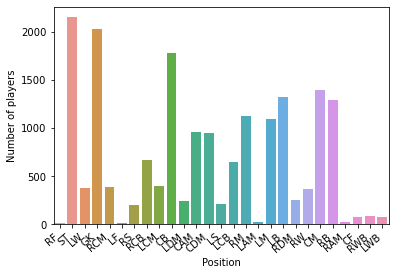

<Figure size 5760x2880 with 0 Axes>

In [9]:
ax = sns.countplot(x = data['Position'])
plt.figure(figsize=(80, 40))
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
ax.set_xlabel('Position') 
ax.set_ylabel('Number of players')
plt.tight_layout()
plt.show()

### Age
Every football player must be considered by their age. It contributes to their market value.

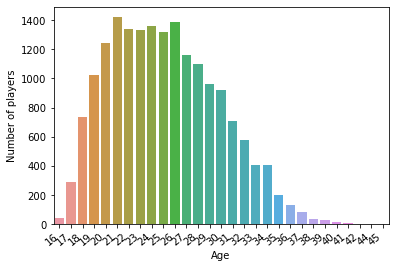

<Figure size 5760x2880 with 0 Axes>

In [10]:
ax = sns.countplot(x = data['Age'])
plt.figure(figsize=(80, 40))
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
ax.set_xlabel('Age') 
ax.set_ylabel('Number of players')
plt.tight_layout()
plt.show()

### Potential 
Every football player has a unique quality called potential. It describes their expertise, which highly contributes to their market value.

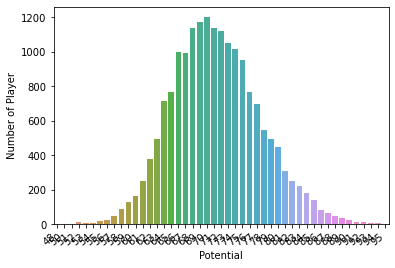

<Figure size 5760x2880 with 0 Axes>

In [11]:
ax = sns.countplot(x = data['Potential'])
plt.figure(figsize=(80, 40))
ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
ax.set_xlabel('Potential') 
ax.set_ylabel('Number of Player')
plt.tight_layout()
plt.show()

### Drop any column that aren't necessary for the model.

In [12]:
data=data.drop(['Name','Unnamed:0','ID','Photo','Flag','Overall','ClubLogo', 'Special', 'InternationalReputation', 'WeakFoot',
               'SkillMoves','WorkRate','BodyType','RealFace','JerseyNumber','Joined','LoanedFrom','ContractValidUntil',
                'Weight','Crossing','Finishing','HeadingAccuracy','ShortPassing','Volleys','Dribbling','Curve','FKAccuracy',
                'LongPassing','BallControl','Acceleration','SprintSpeed','Agility','Reactions','Balance','ShotPower','Jumping',
                'Stamina','Strength','LongShots','Aggression','Interceptions','Positioning','Vision','Penalties','Composure',
                'Marking','SlidingTackle','StandingTackle','ReleaseClause'], axis=1)

data.head(10)

,Age,Nationality,Potential,Club,Value,Wage,PreferredFoot,Position,Height,LS,...,LB,LCB,CB,RCB,RB,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
0,31,Argentina,94,FC Barcelona,€110.5M,€565K,Left,RF,5'7,88.0,...,59.0,47.0,47.0,47.0,59.0,6.0,11.0,15.0,14.0,8.0
1,33,Portugal,94,Juventus,€77M,€405K,Right,ST,6'2,91.0,...,61.0,53.0,53.0,53.0,61.0,7.0,11.0,15.0,14.0,11.0
2,26,Brazil,93,Paris Saint-Germain,€118.5M,€290K,Right,LW,5'9,84.0,...,60.0,47.0,47.0,47.0,60.0,9.0,9.0,15.0,15.0,11.0
3,27,Spain,93,Manchester United,€72M,€260K,Right,GK,6'4,NaN,...,NaN,NaN,NaN,NaN,NaN,90.0,85.0,87.0,88.0,94.0
4,27,Belgium,92,Manchester City,€102M,€355K,Right,RCM,5'11,82.0,...,73.0,66.0,66.0,66.0,73.0,15.0,13.0,5.0,10.0,13.0
5,27,Belgium,91,Chelsea,€93M,€340K,Right,LF,5'8,83.0,...,60.0,49.0,49.0,49.0,60.0,11.0,12.0,6.0,8.0,8.0
6,32,Croatia,91,Real Madrid,€67M,€420K,Right,RCM,5'8,77.0,...,79.0,71.0,71.0,71.0,79.0,13.0,9.0,7.0,14.0,9.0
7,31,Uruguay,91,FC Barcelona,€80M,€455K,Right,RS,6'0,87.0,...,66.0,63.0,63.0,63.0,66.0,27.0,25.0,31.0,33.0,37.0
8,32,Spain,91,Real Madrid,€51M,€380K,Right,RCB,6'0,73.0,...,84.0,87.0,87.0,87.0,84.0,11.0,8.0,9.0,7.0,11.0
9,25,Slovenia,93,Atlético Madrid,€68M,€94K,Right,GK,6'2,NaN,...,NaN,NaN,NaN,NaN,NaN,86.0,92.0,78.0,88.0,89.0


### Fill up the empty rows (NaN) with the dataset's mean value
There are many characteristics that are unimportant for goalkeepers, which is why some of their rows were empty.

In [13]:
column_means = data.mean()
data = data.fillna(column_means)
data

,Age,Nationality,Potential,Club,Value,Wage,PreferredFoot,Position,Height,LS,...,LB,LCB,CB,RCB,RB,GKDiving,GKHandling,GKKicking,GKPositioning,GKReflexes
0,31,Argentina,94,FC Barcelona,€110.5M,€565K,Left,RF,5'7,88.00000,...,59.000000,47.000000,47.000000,47.000000,59.000000,6.0,11.0,15.0,14.0,8.0
1,33,Portugal,94,Juventus,€77M,€405K,Right,ST,6'2,91.00000,...,61.000000,53.000000,53.000000,53.000000,61.000000,7.0,11.0,15.0,14.0,11.0
2,26,Brazil,93,Paris Saint-Germain,€118.5M,€290K,Right,LW,5'9,84.00000,...,60.000000,47.000000,47.000000,47.000000,60.000000,9.0,9.0,15.0,15.0,11.0
3,27,Spain,93,Manchester United,€72M,€260K,Right,GK,6'4,57.81547,...,56.806786,55.614626,55.614626,55.614626,56.806786,90.0,85.0,87.0,88.0,94.0
4,27,Belgium,92,Manchester City,€102M,€355K,Right,RCM,5'11,82.00000,...,73.000000,66.000000,66.000000,66.000000,73.000000,15.0,13.0,5.0,10.0,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,19,England,65,Crewe Alexandra,€60K,€1K,Right,CM,5'9,42.00000,...,45.000000,45.000000,45.000000,45.000000,45.000000,10.0,13.0,7.0,8.0,9.0
18203,19,Sweden,63,Trelleborgs FF,€60K,€1K,Right,ST,6'3,45.00000,...,29.000000,32.000000,32.000000,32.000000,29.000000,10.0,9.0,9.0,5.0,12.0
18204,16,England,67,Cambridge United,€60K,€1K,Right,ST,5'8,45.00000,...,33.000000,28.000000,28.000000,28.000000,33.000000,6.0,5.0,10.0,6.0,13.0
18205,17,England,66,Tranmere Rovers,€60K,€1K,Right,RW,5'10,47.00000,...,35.000000,31.000000,31.000000,31.000000,35.000000,14.0,6.0,14.0,8.0,9.0


### Remove the Pounds symbol and letters from the players' wages and values.

In [14]:
data.Wage = data.Wage.str.replace("€","")
data.Wage = data.Wage.str.replace("K","").astype("float")
data.Wage.head() 

0    565.0
1    405.0
2    290.0
3    260.0
4    355.0
Name: Wage, dtype: float64

In [15]:
data.Value = data.Value.str.replace("€","")
data.Value = data.Value.str.replace("M","")
data.Value = data.Value.str.replace("K","").astype("float")
data.Value.head() 

0    110.5
1     77.0
2    118.5
3     72.0
4    102.0
Name: Value, dtype: float64

### One-hot encoding
This is used to convert all categorical variable into indicator variable i.e., (0's and 1's)

In [16]:
dummies=pd.get_dummies(data)
dummies

,Age,Potential,Value,Wage,LS,ST,RS,LW,LF,CF,...,Height_6'0,Height_6'1,Height_6'2,Height_6'3,Height_6'4,Height_6'5,Height_6'6,Height_6'7,Height_6'8,Height_6'9
0,31,94,110.5,565.0,88.00000,88.00000,88.00000,92.00000,93.00000,93.00000,...,0,0,0,0,0,0,0,0,0,0
1,33,94,77.0,405.0,91.00000,91.00000,91.00000,89.00000,90.00000,90.00000,...,0,0,1,0,0,0,0,0,0,0
2,26,93,118.5,290.0,84.00000,84.00000,84.00000,89.00000,89.00000,89.00000,...,0,0,0,0,0,0,0,0,0,0
3,27,93,72.0,260.0,57.81547,57.81547,57.81547,59.03765,58.71939,58.71939,...,0,0,0,0,1,0,0,0,0,0
4,27,92,102.0,355.0,82.00000,82.00000,82.00000,87.00000,87.00000,87.00000,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,19,65,60.0,1.0,42.00000,42.00000,42.00000,44.00000,44.00000,44.00000,...,0,0,0,0,0,0,0,0,0,0
18203,19,63,60.0,1.0,45.00000,45.00000,45.00000,39.00000,42.00000,42.00000,...,0,0,0,1,0,0,0,0,0,0
18204,16,67,60.0,1.0,45.00000,45.00000,45.00000,45.00000,46.00000,46.00000,...,0,0,0,0,0,0,0,0,0,0
18205,17,66,60.0,1.0,47.00000,47.00000,47.00000,47.00000,46.00000,46.00000,...,0,0,0,0,0,0,0,0,0,0


### Store the dummy method into variable X

In [17]:
X=dummies
X

,Age,Potential,Value,Wage,LS,ST,RS,LW,LF,CF,...,Height_6'0,Height_6'1,Height_6'2,Height_6'3,Height_6'4,Height_6'5,Height_6'6,Height_6'7,Height_6'8,Height_6'9
0,31,94,110.5,565.0,88.00000,88.00000,88.00000,92.00000,93.00000,93.00000,...,0,0,0,0,0,0,0,0,0,0
1,33,94,77.0,405.0,91.00000,91.00000,91.00000,89.00000,90.00000,90.00000,...,0,0,1,0,0,0,0,0,0,0
2,26,93,118.5,290.0,84.00000,84.00000,84.00000,89.00000,89.00000,89.00000,...,0,0,0,0,0,0,0,0,0,0
3,27,93,72.0,260.0,57.81547,57.81547,57.81547,59.03765,58.71939,58.71939,...,0,0,0,0,1,0,0,0,0,0
4,27,92,102.0,355.0,82.00000,82.00000,82.00000,87.00000,87.00000,87.00000,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18202,19,65,60.0,1.0,42.00000,42.00000,42.00000,44.00000,44.00000,44.00000,...,0,0,0,0,0,0,0,0,0,0
18203,19,63,60.0,1.0,45.00000,45.00000,45.00000,39.00000,42.00000,42.00000,...,0,0,0,1,0,0,0,0,0,0
18204,16,67,60.0,1.0,45.00000,45.00000,45.00000,45.00000,46.00000,46.00000,...,0,0,0,0,0,0,0,0,0,0
18205,17,66,60.0,1.0,47.00000,47.00000,47.00000,47.00000,46.00000,46.00000,...,0,0,0,0,0,0,0,0,0,0


### Standardize the dataset
Now let's normalize the dataset. But why do i need normalization in the first place? Normalization is a statistical method that helps mathematical-based algorithms to interpret features with different magnitudes and distributions equally. I used StandardScaler() to normalize the dataset.

In [18]:
players_scale = preprocessing.StandardScaler().fit(X).transform(X)
players_scale[0:5]

array([[ 1.25867833,  3.69809177, -0.53366675, ..., -0.03398138,
        -0.02344229, -0.01048141],
       [ 1.68696087,  3.69809177, -0.64936073, ..., -0.03398138,
        -0.02344229, -0.01048141],
       [ 0.18797198,  3.53512784, -0.50603833, ..., -0.03398138,
        -0.02344229, -0.01048141],
       [ 0.40211325,  3.53512784, -0.66662849, ..., -0.03398138,
        -0.02344229, -0.01048141],
       [ 0.40211325,  3.3721639 , -0.56302194, ..., -0.03398138,
        -0.02344229, -0.01048141]])

In [19]:
#Store the scaled data into a dataframe object
df_players = pd.DataFrame(players_scale, columns=X.columns)
df_players.head()

,Age,Potential,Value,Wage,LS,ST,RS,LW,LF,CF,...,Height_6'0,Height_6'1,Height_6'2,Height_6'3,Height_6'4,Height_6'5,Height_6'6,Height_6'7,Height_6'8,Height_6'9
0,1.258678,3.698092,-0.533667,25.240993,3.521791e+00,3.521791e+00,3.521791e+00,3.552838,3.709879,3.709879,...,-0.433568,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481
1,1.686961,3.698092,-0.649361,17.967832,3.871817e+00,3.871817e+00,3.871817e+00,3.229484,3.385216,3.385216,...,-0.433568,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481
2,0.187972,3.535128,-0.506038,12.740247,3.055089e+00,3.055089e+00,3.055089e+00,3.229484,3.276995,3.276995,...,-0.433568,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481
3,0.402113,3.535128,-0.666628,11.376529,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.433568,-0.342144,-0.352766,-0.239794,4.827879,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481
4,0.402113,3.372164,-0.563022,15.694969,2.821739e+00,2.821739e+00,2.821739e+00,3.013914,3.060553,3.060553,...,-0.433568,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481


# K-Means Algorithm

## The following is the analytical strategy used in the K-means experiment:

### 1. Applying the elbow method to determine the optimal number of K using the silhouette coefficient
### 2. Applying K-means++ to the original dataset 
### 3. Hyperparameter tuning for K-means
### 4. Applying K-means++ to PCA


### 1. Applying the elbow method to determine the optimal number of K using the silhouette coefficient
inertia: (sum of squared error between each point and its cluster center) as a function of the number of clusters.

Text(0, 0.5, 'Inertia')

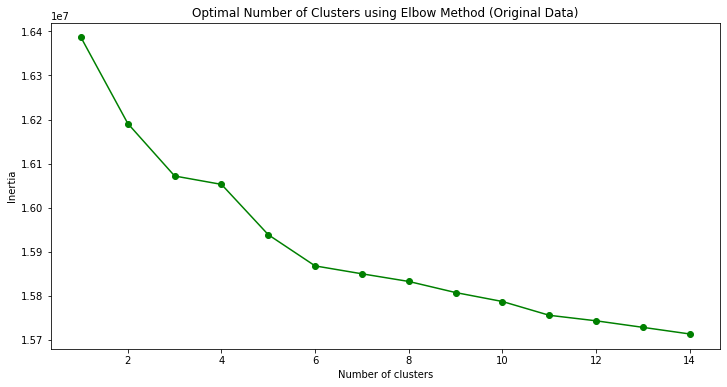

In [20]:
inertia = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(df_players)
    inertia.append([k, km.inertia_])
    
pca_results = pd.DataFrame({'Cluster': range(1,15), 'SSE': inertia})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(inertia)[0], pd.DataFrame(inertia)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (Original Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 2. Applying K-means++ to the original dataset

The plot indicates that the number of clusters should be between 4 and 5, but for the purpose of simplicity, I chose 4 as my preferred number. Compute the sihouette score using k-means++ on the original dataset

In [21]:
kmeans_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++').fit(df_players)
print('KMeans Scaled Silhouette Score: {}'.format(silhouette_score(df_players, 
                                                                   kmeans_scale.labels_, metric='euclidean')))
labels_scale = kmeans_scale.labels_
clusters_scale = pd.concat([df_players, pd.DataFrame({'cluster_scaled':labels_scale})], axis=1)

KMeans Scaled Silhouette Score: 0.008050738505539628


### 3. Hyperparameter tuning for K-means

In [22]:
parameters = {'n_clusters': [2, 3, 4, 5, 10, 20, 30]}

parameter_grid = ParameterGrid(parameters)

In [23]:
list(parameter_grid)

[{'n_clusters': 2},
 {'n_clusters': 3},
 {'n_clusters': 4},
 {'n_clusters': 5},
 {'n_clusters': 10},
 {'n_clusters': 20},
 {'n_clusters': 30}]

In [24]:
best_score = -1
model = KMeans()

### 3.1. Fine-tune the K-means model

In [25]:
for g in parameter_grid:
    model.set_params(**g)
    model.fit(df_players)

    ss = metrics.silhouette_score(df_players, model.labels_)
    print('Parameter: ', g, 'Score: ', ss)
    if ss > best_score:
        best_score = ss
        best_grid = g

Parameter:  {'n_clusters': 2} Score:  0.012959512446491819
Parameter:  {'n_clusters': 3} Score:  0.010839944476846006
Parameter:  {'n_clusters': 4} Score:  0.008049264996107327
Parameter:  {'n_clusters': 5} Score:  0.007859256645351588
Parameter:  {'n_clusters': 10} Score:  -0.004059966997137637
Parameter:  {'n_clusters': 20} Score:  -0.005147238810997196
Parameter:  {'n_clusters': 30} Score:  0.00022849196256195147


### 3.2. Get the best silhouette score along with the number of clusters

In [26]:
best_grid

{'n_clusters': 2}

### 3.3. A scatter plot of the original dataset using K-means

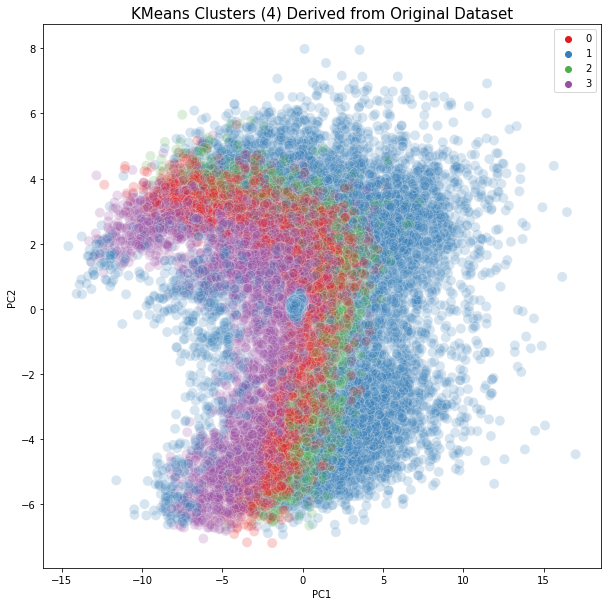

In [44]:
labels_scale=k_means.labels_
pca2 = PCA(n_components=3).fit(df_players)
pca2d = pca2.transform(df_players)
plt.figure(figsize = (10,10))
sns.scatterplot(pca2d[:,0], pca2d[:,1], 
                hue=labels_scale, 
                palette='Set1',
                s=100, alpha=0.2).set_title('KMeans Clusters (4) Derived from Original Dataset', fontsize=15)
plt.legend()
plt.ylabel('PC2')
plt.xlabel('PC1')
plt.show()

### 3.4. Plot a 3-D graph of the original dataset

In [48]:
Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
labels = labels_scale
trace = go.Scatter3d(x=pca2d[:,0], y=pca2d[:,1], z=pca2d[:,2], mode='markers',marker=dict(color = labels, colorscale='Viridis', size = 10, line = dict(color = 'gray',width = 5)))
layout = go.Layout(margin=dict(l=0,r=0),scene = Scene, height = 1000,width = 1000)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.show()

### 4. Applying K-means++ to PCA 

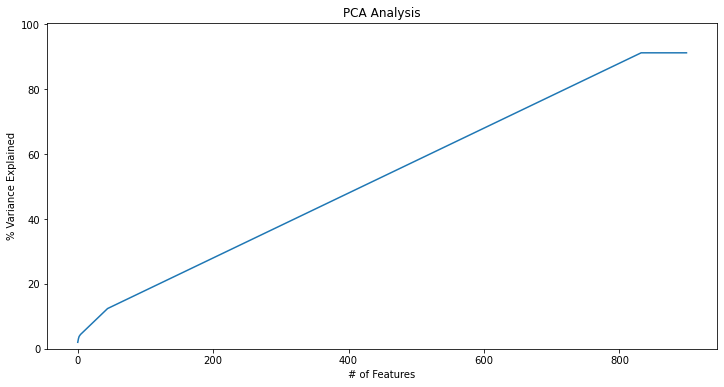

In [30]:
#n_components=900 because we have 900 features in the dataset
pca = PCA(n_components=900)
pca.fit(df_players)
variance = pca.explained_variance_ratio_
var = np.cumsum(np.round(variance, 3)*100)
plt.figure(figsize=(12,6))
plt.ylabel('% Variance Explained')
plt.xlabel('# of Features')
plt.title('PCA Analysis')
plt.ylim(0,100.5)
plt.plot(var)

### 4.1. Examine the n components with a value of 2

In [31]:
pca = PCA(n_components=2)
pca_scale = pca.fit_transform(df_players)
pca_df_scale = pd.DataFrame(pca_scale,  columns=['pc1','pc2'])
print(pca.explained_variance_ratio_)

[0.01965028 0.011051  ]


### 4.2. Evaluate the elbow method distribution using PCA (2)

Text(0, 0.5, 'Inertia')

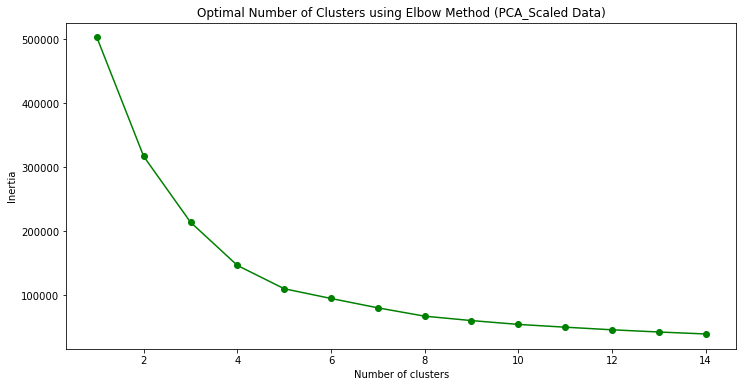

In [32]:
sse = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(pca_df_scale)
    sse.append([k, km.inertia_])
    
pca_results_scale = pd.DataFrame({'Cluster': range(1,15), 'SSE': sse})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(sse)[0], pd.DataFrame(sse)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (PCA_Scaled Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 4.3. After applying PCA (2), recalculate the silhouette score

In [33]:
kmeans_pca_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++', random_state=42).fit(pca_df_scale)

print('KMeans PCA Scaled Silhouette Score: {}'.format(silhouette_score(pca_df_scale, kmeans_pca_scale.labels_, metric='euclidean')))
labels_pca_scale = kmeans_pca_scale.labels_
clusters_pca_scale = pd.concat([pca_df_scale, 
                                pd.DataFrame({'pca_clusters':labels_pca_scale})], axis=1)

KMeans PCA Scaled Silhouette Score: 0.41199903569930413


### 4.4. Examine the n components with a value of 3

In [34]:
pca = PCA(n_components=3)
pca_scale = pca.fit_transform(df_players)
pca_df_scale = pd.DataFrame(pca_scale,  columns=['pc1','pc2','pc3'])
print(pca.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679]


### 4.5. Evaluate the elbow method distribution using PCA (3)

Text(0, 0.5, 'Inertia')

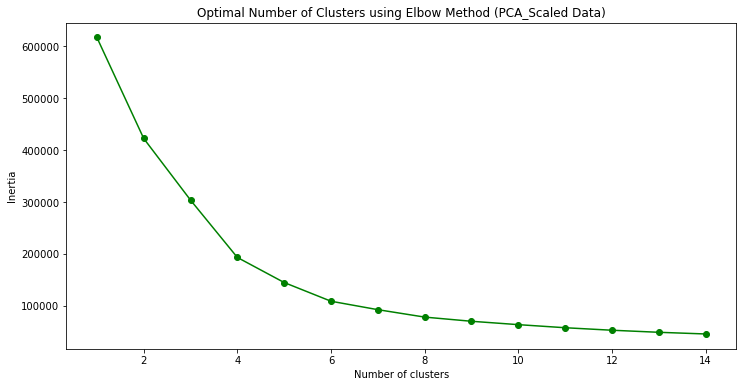

In [35]:
sse = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(pca_df_scale)
    sse.append([k, km.inertia_])
    
pca_results = pd.DataFrame({'Cluster': range(1,15), 'SSE': sse})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(sse)[0], pd.DataFrame(sse)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (PCA_Scaled Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 4.6.  After applying PCA (3), recalculate the silhouette score

In [36]:
kmeans_pca_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++', random_state=42).fit(pca_df_scale)

print('KMeans PCA Scaled Silhouette Score: {}'.format(silhouette_score(pca_df_scale, kmeans_pca_scale.labels_, metric='euclidean')))
labels_pca_scale = kmeans_pca_scale.labels_
clusters_pca_scale = pd.concat([pca_df_scale, 
                                pd.DataFrame({'pca_clusters':labels_pca_scale})], axis=1)

KMeans PCA Scaled Silhouette Score: 0.45859063349807444


### 4.7. Examine the n components with a value of 4

In [37]:
pca = PCA(n_components=4)
pca_scale = pca.fit_transform(df_players)
pca_df_scale = pd.DataFrame(pca_scale,  columns=['pc1','pc2','pc3','pc4'])
print(pca.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679 0.00271916]


### 4.8. Evaluate the elbow method distribution using PCA (4)

Text(0, 0.5, 'Inertia')

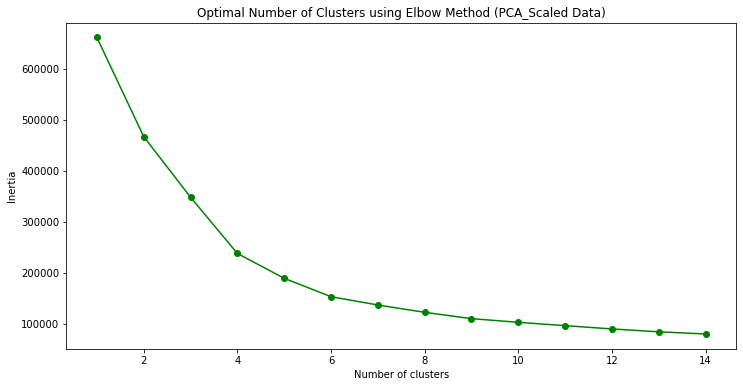

In [38]:
sse = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(pca_df_scale)
    sse.append([k, km.inertia_])
    
pca_results = pd.DataFrame({'Cluster': range(1,15), 'SSE': sse})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(sse)[0], pd.DataFrame(sse)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (PCA_Scaled Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 4.9. After applying PCA (4), recalculate the silhouette score using K-means++

In [39]:
kmeans_pca_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++', random_state=42).fit(pca_df_scale)

print('KMeans PCA Scaled Silhouette Score: {}'.format(silhouette_score(pca_df_scale, kmeans_pca_scale.labels_, metric='euclidean')))
labels_pca_scale = kmeans_pca_scale.labels_
clusters_pca_scale = pd.concat([pca_df_scale, 
                                pd.DataFrame({'pca_clusters':labels_pca_scale})], axis=1)

KMeans PCA Scaled Silhouette Score: 0.41152846907975915


### 4.10. Examine the n components with a value of 5

In [40]:
pca = PCA(n_components=5)
pca_scale = pca.fit_transform(df_players)
pca_df_scale = pd.DataFrame(pca_scale,  columns=['pc1','pc2','pc3','pc4','pc5'])
print(pca.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679 0.00271749 0.00249749]


### 4.11. Evaluate the elbow method distribution using PCA (5)

Text(0, 0.5, 'Inertia')

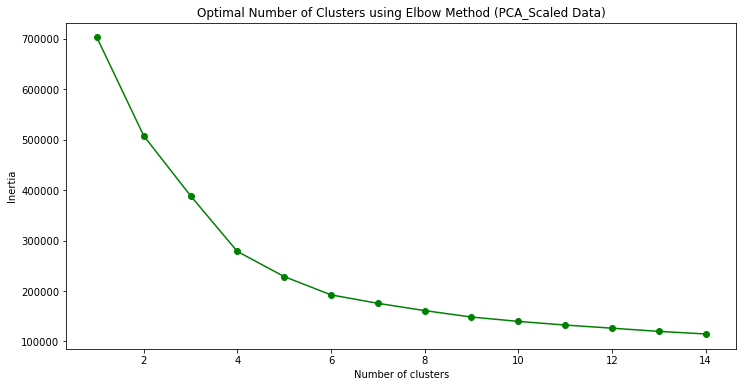

In [41]:
sse = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(pca_df_scale)
    sse.append([k, km.inertia_])
    
pca_results = pd.DataFrame({'Cluster': range(1,15), 'SSE': sse})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(sse)[0], pd.DataFrame(sse)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (PCA_Scaled Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 4.12. After applying PCA (5), recalculate the silhouette score using K-means++

In [42]:
kmeans_pca_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++', random_state=42).fit(pca_df_scale)

print('KMeans PCA Scaled Silhouette Score: {}'.format(silhouette_score(pca_df_scale, kmeans_pca_scale.labels_, metric='euclidean')))
labels_pca_scale = kmeans_pca_scale.labels_
clusters_pca_scale = pd.concat([pca_df_scale, 
                                pd.DataFrame({'pca_clusters':labels_pca_scale})], axis=1)

KMeans PCA Scaled Silhouette Score: 0.37559599548300726


### 4.13. Examine the n components with a value of 30

In [43]:
pca = PCA(n_components=30)
pca_scale = pca.fit_transform(df_players)
pca_df_scale = pd.DataFrame(pca_scale)
print(pca.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679 0.00272677 0.0025159  0.00226818
 0.00218653 0.00217503 0.00214357 0.0021215  0.00210264 0.00207961
 0.00205502 0.00201709 0.00200175 0.00198892 0.0019641  0.001955
 0.0019477  0.00194323 0.0019148  0.00190983 0.00187501 0.00186612
 0.00185211 0.00183693 0.00182591 0.00179531 0.00178596 0.00176364]


### 4.14. Evaluate the elbow method distribution using PCA (30)

Text(0, 0.5, 'Inertia')

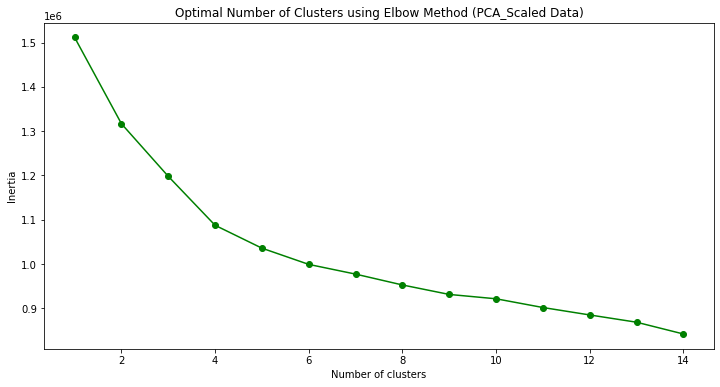

In [44]:
sse = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(pca_df_scale)
    sse.append([k, km.inertia_])
    
pca_results = pd.DataFrame({'Cluster': range(1,15), 'SSE': sse})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(sse)[0], pd.DataFrame(sse)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (PCA_Scaled Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 4.15. After applying PCA (30), recalculate the silhouette score using K-means++

In [45]:
kmeans_pca_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++', random_state=42).fit(pca_df_scale)

print('KMeans PCA Scaled Silhouette Score: {}'.format(silhouette_score(pca_df_scale, kmeans_pca_scale.labels_, metric='euclidean')))
labels_pca_scale = kmeans_pca_scale.labels_
clusters_pca_scale = pd.concat([pca_df_scale, 
                                pd.DataFrame({'pca_clusters':labels_pca_scale})], axis=1)

KMeans PCA Scaled Silhouette Score: 0.157358577230648


### 4.16. For the K-means, PCA with a value of 3 produced the best silhouette score.

In [46]:
pca = PCA(n_components=3)
pca_scale = pca.fit_transform(df_players)
pca_df_scale = pd.DataFrame(pca_scale,  columns=['pc1','pc2','pc3'])
print(pca.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679]


### 4.17. Evaluate the elbow method distribution using PCA (3)

Text(0, 0.5, 'Inertia')

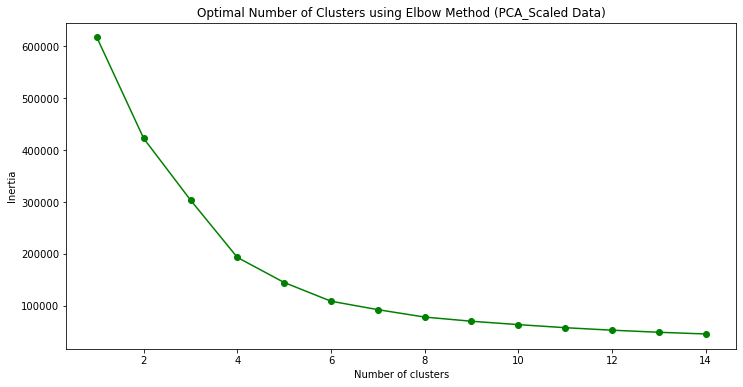

In [47]:
sse = []
k_list = range(1, 15)

for k in k_list:
    km = KMeans(n_clusters=k)
    km.fit(pca_df_scale)
    sse.append([k, km.inertia_])
    
pca_results = pd.DataFrame({'Cluster': range(1,15), 'SSE': sse})
plt.figure(figsize=(12,6))
plt.plot(pd.DataFrame(sse)[0], pd.DataFrame(sse)[1], marker='o', color='green')
plt.title('Optimal Number of Clusters using Elbow Method (PCA_Scaled Data)')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

### 4.18. After applying PCA (3), recalculate the silhouette score using K-means++
I tried a few other numbers for the n component, but it appears that **0.458** is the highest possible score for the silhouette.

In [48]:
kmeans_pca_scale = KMeans(n_clusters=4, n_init=100, max_iter=400, init='k-means++', random_state=42).fit(pca_df_scale)

print('KMeans PCA Scaled Silhouette Score: {}'.format(silhouette_score(pca_df_scale, kmeans_pca_scale.labels_, metric='euclidean')))
labels_pca_scale = kmeans_pca_scale.labels_
clusters_pca_scale = pd.concat([pca_df_scale, 
                                pd.DataFrame({'pca_clusters':labels_pca_scale})], axis=1)

KMeans PCA Scaled Silhouette Score: 0.45849398372242633


In [49]:
pca=[{'Number of PCA':2,
         'Number of Clusters': 4,
         'Silhouette Score': 0.411
         },
        {
         'Number of PCA':3,
         'Number of Clusters': 4,
         'Silhouette Score': 0.458
        },
        {'Number of PCA':4,
         'Number of Clusters': 4,
         'Silhouette Score': 0.410
         },
        {'Number of PCA':5,
         'Number of Clusters': 4,
         'Silhouette Score': 0.374
         },
        {'Number of PCA':30,
         'Number of Clusters': 4,
         'Silhouette Score': 0.158
         },]
df=pd.DataFrame(pca, index=['Princpal Component Analysis','Princpal Component Analysis','Princpal Component Analysis','Princpal Component Analysis', 'Princpal Component Analysis'])
df.head()

,Number of PCA,Number of Clusters,Silhouette Score
Princpal Component Analysis,2,4,0.411
Princpal Component Analysis,3,4,0.458
Princpal Component Analysis,4,4,0.410
Princpal Component Analysis,5,4,0.374
Princpal Component Analysis,30,4,0.158


### 4.19. Hyperparameter tunning on K-means after applying PCA (3)

In [50]:
parameters = {'n_clusters': [2, 3, 4, 5, 10, 20, 30]}

parameter_grid = ParameterGrid(parameters)

In [51]:
list(parameter_grid)

[{'n_clusters': 2},
 {'n_clusters': 3},
 {'n_clusters': 4},
 {'n_clusters': 5},
 {'n_clusters': 10},
 {'n_clusters': 20},
 {'n_clusters': 30}]

In [52]:
best_score = -1
model = KMeans()

### 4.20. Fine-tune the model

In [53]:
for g in parameter_grid:
    model.set_params(**g)
    model.fit(pca_df_scale)

    ss = metrics.silhouette_score(pca_df_scale, model.labels_)
    print('Parameter: ', g, 'Score: ', ss)
    if ss > best_score:
        best_score = ss
        best_grid = g

Parameter:  {'n_clusters': 2} Score:  0.2976376038874342
Parameter:  {'n_clusters': 3} Score:  0.39892913174019407
Parameter:  {'n_clusters': 4} Score:  0.4586248972714633
Parameter:  {'n_clusters': 5} Score:  0.4428654953611375
Parameter:  {'n_clusters': 10} Score:  0.40351789403299737
Parameter:  {'n_clusters': 20} Score:  0.3812048611644125
Parameter:  {'n_clusters': 30} Score:  0.33479713240193687


### 4.21. The best silhouette score for K-means++ algorithm is (4) clusters

In [54]:
best_grid

{'n_clusters': 4}

### 4.22. Present a graph that was derived from PCA (3) using K-means++

C:\Users\danla\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


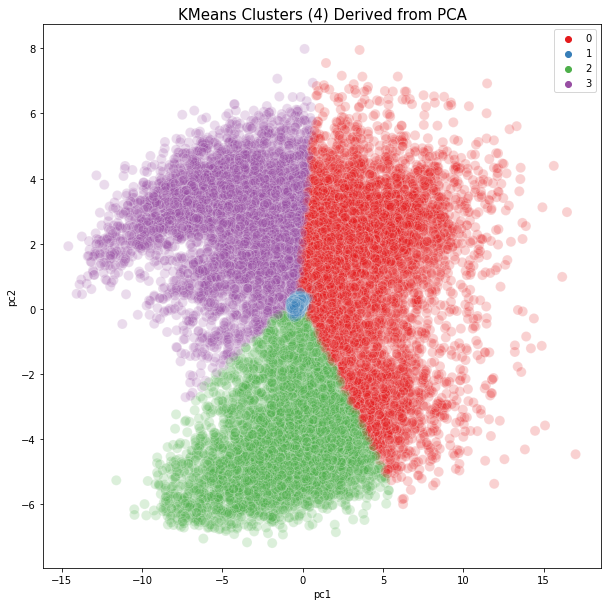

In [52]:
plt.figure(figsize = (10,10))
sns.scatterplot(clusters_pca_scale.iloc[:,0],
                clusters_pca_scale.iloc[:,1], 
                hue=labels_pca_scale, palette='Set1', s=100, 
                alpha=0.2).set_title('KMeans Clusters (4) Derived from PCA', fontsize=15)
plt.legend()
plt.show()

### 4.23. Plot a 3-D graph of K-means clusters derived from PCA (3)

In [45]:
Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
labels = labels_scale
trace = go.Scatter3d(x=pca2d[:,0], y=pca2d[:,1], z=pca2d[:,2], mode='markers',marker=dict(color = labels, colorscale='Viridis', size = 10, line = dict(color = 'gray',width = 5)))
layout = go.Layout(margin=dict(l=0,r=0),scene = Scene, height = 1000,width = 1000)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.show()

# DBSCAN Algorithm

DBSCAN - Density-Based Spatial Clustering of Applications with Noise. Finds core samples of high density and expands clusters from them. Good for data which contains clusters of similar density.
Dense region, Sparse region, Core point, Border point, Noise point , Density edge , Density connected points

The DBSCAN algorithm uses two parameters:

**min points:** The minimum number of points (a threshold) clustered together for a region to be considered dense.

**epsilon (ε):** A distance measure that will be used to locate the points in the neighborhood of any point.

The following is the analytical strategy used in the DBSCAN algorithm:


### 1. Applying feature extraction to DBSCAN
### 2. Construct a 3-D graph to illustrate each cluster distribution (Original Dataset).
### 3. Apply elbow method using nearest neighbors
### 4. Applying DBSCAN to the original dataset using (eps:0.4; minpts:4)
### 5. Hyperparameter tuning for DBSCAN(epsilon & minimum points)
### 6. Construct a 3-D graph to illustrate each cluster distribution (original dataset)
### 7. Save the results to a file and then analyse them after adjusting the PCA parameters.
### 8. Construct a 3-D graph to illustrate each cluster distribution.
### 9. Apply a value range of (2,3, & 4) for the PCA n component and examine the results
### 10. Eliminate the rows containing noise (-1), store the model label back into a dataframe object



### 1. Applying feature extraction to DBSCAN

In [57]:
pca = PCA(n_components=3)
pca.fit(df_players)
pca_scale = pca.transform(df_players)
pca_df = pd.DataFrame(pca_scale, columns=['pc1', 'pc2', 'pc3'])
print(pca.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679]


### 2. Construct a 3-D graph to illustrate each cluster distribution (original dataset)

In [58]:
Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
trace = go.Scatter3d(x=pca_df.iloc[:,0], y=pca_df.iloc[:,1], z=pca_df.iloc[:,2],
                     mode='markers',marker=dict(colorscale='Greys', opacity=0.3, size = 10, ))
layout = go.Layout(margin=dict(l=0,r=0),scene = Scene, height = 1000,width = 1000)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.update_layout(title='DBSCAN clusters Derived from Original Data', font=dict(size=12,))
fig.show()

### 3. Applying the elbow method using nearest neighbors (2)

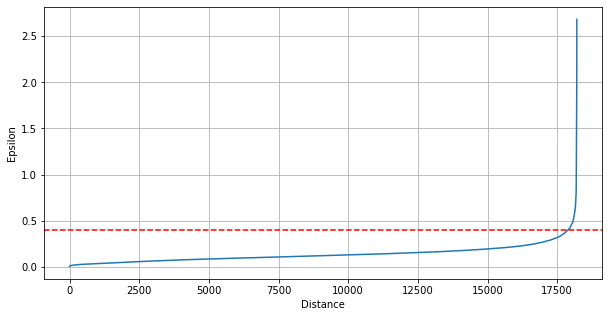

In [64]:
# we use nearestneighbors for calculating distance between points
neigh=NearestNeighbors(n_neighbors=2)
distance=neigh.fit(pca_df)
distances,indices=distance.kneighbors(pca_df)
sorting_distances=np.sort(distances,axis=0)
sorted_distances=sorting_distances[:,1]
plt.figure(figsize=(10,5))
plt.plot(sorted_distances)
plt.xlabel('Distance')
plt.ylabel('Epsilon')
plt.axhline(y=0.4, color='red', ls='--')
plt.grid()
plt.show()

### 4. Applying DBSCAN to the original dataset using (eps:0.4; minpts:4)

In [61]:
dbscan = DBSCAN(eps=0.4, min_samples=4).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 30
Estimated number of noise points: 511
Silhouette Coefficient: -0.222


### 5. Construct a 3-D graph to illustrate each cluster distribution (original dataset)

In [63]:
Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
labels = db.labels_
trace = go.Scatter3d(x=pca_df.iloc[:,0], y=pca_df.iloc[:,1], z=pca_df.iloc[:,2], mode='markers',marker=dict(color = labels, colorscale='Viridis', size = 10, line = dict(color = 'gray',width = 5)))
layout = go.Layout(scene = Scene, height = 1000,width = 1000)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.update_layout(title='DBSCAN clusters (30) Derived from PCA', font=dict(size=12,))
fig.show()

### 6. Hyperparameter tuning for DBSCAN (epsilon & minimum points)

In [65]:
pca_eps_values = np.arange(0.2,2.6,0.1) 
pca_min_samples = np.arange(2,11) 
pca_dbscan_params = list(product(pca_eps_values, pca_min_samples))
pca_no_of_clusters = []
pca_sil_score = []
pca_epsvalues = []
pca_min_samp = []
for p in pca_dbscan_params:
    pca_dbscan_cluster = DBSCAN(eps=p[0], min_samples=p[1]).fit(pca_df)
    pca_epsvalues.append(p[0])
    pca_min_samp.append(p[1])
    pca_no_of_clusters.append(len(np.unique(pca_dbscan_cluster.labels_)))
    pca_sil_score.append(silhouette_score(pca_df, pca_dbscan_cluster.labels_))
pca_eps_min = list(zip(pca_no_of_clusters, pca_sil_score, pca_epsvalues, pca_min_samp))
pca_eps_min_df = pd.DataFrame(pca_eps_min, columns=['no_of_clusters', 'silhouette_score', 'epsilon_values', 'minimum_points'])
pca_eps_min_df

,no_of_clusters,silhouette_score,epsilon_values,minimum_points
0,1181,-0.410203,0.2,2
1,611,-0.446312,0.2,3
2,400,-0.438679,0.2,4
3,319,-0.427433,0.2,5
4,266,-0.428594,0.2,6
...,...,...,...,...
211,3,0.325307,2.5,6
212,3,0.325307,2.5,7
213,3,0.325307,2.5,8
214,3,0.325307,2.5,9


### 7. Save the result to file

In [66]:
pd.DataFrame(pca_eps_min_df).to_csv('dbscanresultpca1.csv', index=False)

### 7.1 I evaluated the obtained result to fine-tune the model

In [67]:
dbscan = DBSCAN(eps=1.3, min_samples=4).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 3
Estimated number of noise points: 14
Silhouette Coefficient: 0.302


### 8. Construct a 3-D graph to illustrate (4) cluster distributions using the above parameters

In [1]:
#Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
#labels = dbscan.labels_
#trace = go.Scatter3d(x=pca_df.iloc[:,0], y=pca_df.iloc[:,1], z=pca_df.iloc[:,2], mode='markers', marker=dict(color = labels, colorscale='Viridis', size = 10, line = dict(color = 'gray',width = 5)))
#layout = go.Layout(scene = Scene, height = 1000,width = 1000)
#data = [trace]
#fig = go.Figure(data = data, layout = layout)
#fig.update_layout(title='DBSCAN clusters (4) Derived from PCA', font=dict(size=12,))
#fig.show()

### 9. Apply a value range of (2,3, & 4) for the PCA n component and examine the results
Applying PCA (2) to DBSCAN (original dataset)


In [69]:
pca_dbscan = PCA(n_components=2)
pca_dbscan.fit(df_players)
pca_scale_dbscan = pca_dbscan.transform(df_players)
pca_df = pd.DataFrame(pca_scale_dbscan, columns=['pc1', 'pc2'])
print(pca_dbscan.explained_variance_ratio_)

[0.01965028 0.011051  ]


### 9.1. Calculate the epsilon and minimum point parameters while simultaneously eliminating noise to produce the silhouette coefficient

In [70]:
dbscan = DBSCAN(eps=2, min_samples=2).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 1
Estimated number of noise points: 2
Silhouette Coefficient: 0.595


### 9.2. Hyperparameter tuning for DBSCAN (epsilon & minimum points)

In [71]:
pca_eps_values = np.arange(0.2,2.1,0.1) 
pca_min_samples = np.arange(2,11) 
pca_dbscan_params = list(product(pca_eps_values, pca_min_samples))
pca_no_of_clusters = []
pca_sil_score = []
pca_epsvalues = []
pca_min_samp = []
for p in pca_dbscan_params:
    pca_dbscan_cluster = DBSCAN(eps=p[0], min_samples=p[1]).fit(pca_df)
    pca_epsvalues.append(p[0])
    pca_min_samp.append(p[1])
    pca_no_of_clusters.append(len(np.unique(pca_dbscan_cluster.labels_)))
    pca_sil_score.append(silhouette_score(pca_df, pca_dbscan_cluster.labels_))
pca_eps_min = list(zip(pca_no_of_clusters, pca_sil_score, pca_epsvalues, pca_min_samp))
pca_eps_min_df = pd.DataFrame(pca_eps_min, columns=['no_of_clusters', 'silhouette_score', 'epsilon_values', 'minimum_points'])
pca_eps_min_df

,no_of_clusters,silhouette_score,epsilon_values,minimum_points
0,216,-0.525081,0.2,2
1,118,-0.507156,0.2,3
2,84,-0.515870,0.2,4
3,77,-0.531785,0.2,5
4,77,-0.516031,0.2,6
...,...,...,...,...
166,2,0.583785,2.0,6
167,2,0.583785,2.0,7
168,2,0.583785,2.0,8
169,2,0.583785,2.0,9


### 9.3. Save the result to file

In [72]:
pd.DataFrame(pca_eps_min_df).to_csv('dbscanresultpca2.csv', index=False)

### 9.4. I evaluated the obtained result to fine-tune the model

In [73]:
dbscan = DBSCAN(eps=1.2, min_samples=2).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 3
Estimated number of noise points: 5
Silhouette Coefficient: 0.500


### Apply a value of 4 for the PCA n component and examine the results

In [74]:
pca_dbscan = PCA(n_components=4)
pca_dbscan.fit(df_players)
pca_scale_dbscan = pca_dbscan.transform(df_players)
pca_df = pd.DataFrame(pca_scale_dbscan, columns=['pc1', 'pc2','pc3','pc4'])
print(pca_dbscan.explained_variance_ratio_)

[0.01965028 0.011051   0.00693679 0.00271836]


### 9.5. Construct a 3-D graph to illustrate (4) cluster distributions using the above parameters

In [2]:
#Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
#labels = dbscan.labels_
#trace = go.Scatter3d(x=pca_df.iloc[:,0], y=pca_df.iloc[:,1], z=pca_df.iloc[:,2], mode='markers', marker=dict(color = labels, colorscale='Viridis', size = 10, line = dict(color = 'gray',width = 5)))
#layout = go.Layout(scene = Scene, height = 1000,width = 1000)
#data = [trace]
#fig = go.Figure(data = data, layout = layout)
#fig.update_layout(title='DBSCAN clusters (4) Derived from PCA', font=dict(size=12,))
#fig.show()

### 9.6. Calculate the epsilon and minimum point parameters while simultaneously eliminating noise to produce the silhouette coefficient

In [75]:
dbscan = DBSCAN(eps=3.3, min_samples=2).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 1
Estimated number of noise points: 1
Silhouette Coefficient: 0.546


### 9.7 Hyperparameter tuning for DBSCAN (epsilon & minimum points)

In [76]:
pca_eps_values = np.arange(0.2,3.3,0.1) 
pca_min_samples = np.arange(2,11) 
pca_dbscan_params = list(product(pca_eps_values, pca_min_samples))
pca_no_of_clusters = []
pca_sil_score = []
pca_epsvalues = []
pca_min_samp = []
for p in pca_dbscan_params:
    pca_dbscan_cluster = DBSCAN(eps=p[0], min_samples=p[1]).fit(pca_df)
    pca_epsvalues.append(p[0])
    pca_min_samp.append(p[1])
    pca_no_of_clusters.append(len(np.unique(pca_dbscan_cluster.labels_)))
    pca_sil_score.append(silhouette_score(pca_df, pca_dbscan_cluster.labels_))
pca_eps_min = list(zip(pca_no_of_clusters, pca_sil_score, pca_epsvalues, pca_min_samp))
pca_eps_min_df = pd.DataFrame(pca_eps_min, columns=['no_of_clusters', 'silhouette_score', 'epsilon_values', 'minimum_points'])
pca_eps_min_df

,no_of_clusters,silhouette_score,epsilon_values,minimum_points
0,1522,-0.569517,0.2,2
1,411,-0.692574,0.2,3
2,114,-0.691150,0.2,4
3,36,-0.608957,0.2,5
4,13,-0.434491,0.2,6
...,...,...,...,...
274,2,0.546398,3.2,6
275,2,0.546398,3.2,7
276,2,0.546398,3.2,8
277,2,0.546398,3.2,9


### 9.8. Save the result to file

In [77]:
pd.DataFrame(pca_eps_min_df).to_csv('dbscanresultpca3.csv', index=False)

### 9.9. I evaluated the obtained result to fine-tune the model

In [78]:
dbscan = DBSCAN(eps=1.7, min_samples=3).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 3
Estimated number of noise points: 12
Silhouette Coefficient: 0.288


### 9.10. Construct a 3-D graph to illustrate (2) cluster distributions using the above parameters

In [79]:
Scene = dict(xaxis = dict(title  = 'PC1'),yaxis = dict(title  = 'PC2'),zaxis = dict(title  = 'PC3'))
labels = dbscan.labels_
trace = go.Scatter3d(x=pca_df.iloc[:,0], y=pca_df.iloc[:,1], z=pca_df.iloc[:,2], mode='markers',marker=dict(color = labels, colorscale='Viridis', size = 10, line = dict(color = 'gray',width = 5)))
layout = go.Layout(scene = Scene, height = 1000,width = 1000)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.update_layout(title="'DBSCAN Clusters (4) Derived from PCA'", font=dict(size=12,))
fig.show()

### 9.11. For the DBSCAN, PCA with n component value of 2 produced the best silhouette score.

In [80]:
pca_dbscan = PCA(n_components=2)
pca_dbscan.fit(df_players)
pca_scale_dbscan = pca_dbscan.transform(df_players)
pca_df = pd.DataFrame(pca_scale_dbscan)
print(pca_dbscan.explained_variance_ratio_)

[0.01965028 0.011051  ]


### 9.12. Evaluate the obtained result to fine-tune the model

In [81]:
dbscan = DBSCAN(eps=1.2, min_samples=2).fit(pca_df)
labels = dbscan.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)
print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(pca_df, labels))

Estimated number of clusters: 3
Estimated number of noise points: 5
Silhouette Coefficient: 0.500


### 10. Eliminate the rows containing noise (-1), store the model label back into a dataframe object

In [82]:
df_players["Labels"] = labels
df_players.head(10)

,Age,Potential,Value,Wage,LS,ST,RS,LW,LF,CF,...,Height_6'1,Height_6'2,Height_6'3,Height_6'4,Height_6'5,Height_6'6,Height_6'7,Height_6'8,Height_6'9,Labels
0,1.258678,3.698092,-0.533667,25.240993,3.521791e+00,3.521791e+00,3.521791e+00,3.552838,3.709879,3.709879,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,-1
1,1.686961,3.698092,-0.649361,17.967832,3.871817e+00,3.871817e+00,3.871817e+00,3.229484,3.385216,3.385216,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
2,0.187972,3.535128,-0.506038,12.740247,3.055089e+00,3.055089e+00,3.055089e+00,3.229484,3.276995,3.276995,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
3,0.402113,3.535128,-0.666628,11.376529,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.342144,-0.352766,-0.239794,4.827879,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
4,0.402113,3.372164,-0.563022,15.694969,2.821739e+00,2.821739e+00,2.821739e+00,3.013914,3.060553,3.060553,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,-1
5,0.402113,3.209200,-0.594104,15.013110,2.938414e+00,2.938414e+00,2.938414e+00,3.229484,3.168774,3.168774,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
6,1.472820,3.209200,-0.683896,18.649690,2.238362e+00,2.238362e+00,2.238362e+00,2.798345,2.735891,2.735891,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,-1
7,1.258678,3.209200,-0.639000,20.240694,3.405115e+00,3.405115e+00,3.405115e+00,2.906130,3.060553,3.060553,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,2
8,1.472820,3.209200,-0.739153,16.831400,1.771660e+00,1.771660e+00,1.771660e+00,1.181574,1.329019,1.329019,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
9,-0.026169,3.535128,-0.680443,3.830624,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1


### 10.1.  Eliminate rows with noise using DataFrame Object

In [83]:
n_noise_ = list(labels).count(-1)
print('Count:', n_noise_)
indexNames = df_players[df_players['Labels'] == -1 ].index
df_players.drop(indexNames , inplace=True)
df_players.head(10)

Count: 5


,Age,Potential,Value,Wage,LS,ST,RS,LW,LF,CF,...,Height_6'1,Height_6'2,Height_6'3,Height_6'4,Height_6'5,Height_6'6,Height_6'7,Height_6'8,Height_6'9,Labels
1,1.686961,3.698092,-0.649361,17.967832,3.871817e+00,3.871817e+00,3.871817e+00,3.229484,3.385216,3.385216,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
2,0.187972,3.535128,-0.506038,12.740247,3.055089e+00,3.055089e+00,3.055089e+00,3.229484,3.276995,3.276995,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
3,0.402113,3.535128,-0.666628,11.376529,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.342144,-0.352766,-0.239794,4.827879,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
5,0.402113,3.209200,-0.594104,15.013110,2.938414e+00,2.938414e+00,2.938414e+00,3.229484,3.168774,3.168774,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
7,1.258678,3.209200,-0.639000,20.240694,3.405115e+00,3.405115e+00,3.405115e+00,2.906130,3.060553,3.060553,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,2
8,1.472820,3.209200,-0.739153,16.831400,1.771660e+00,1.771660e+00,1.771660e+00,1.181574,1.329019,1.329019,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
9,-0.026169,3.535128,-0.680443,3.830624,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
10,0.830396,3.046236,-0.649361,8.876380,3.405115e+00,3.405115e+00,3.405115e+00,2.582775,2.952333,2.952333,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
11,0.616255,3.046236,-0.651088,15.694969,2.355037e+00,2.355037e+00,2.355037e+00,2.367206,2.519449,2.519449,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1
12,1.472820,3.046236,-0.763328,5.239799,7.215823e-01,7.215823e-01,7.215823e-01,0.211511,0.355031,0.355031,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,1


### 10.2. Confirming the size of the dataset after dropping 5 rows with noise (-1)
**After removing the noisy datapoint, the dataset has been altered. I'll have to re-import the dataset in order to build a classification model.**

In [84]:
df_players.shape

(18202, 901)

### 10.3. Examine the labels

In [85]:
df_players['Labels'].unique()

array([0, 1, 2], dtype=int64)

In [86]:
clusterNum = 4
k_means = KMeans(init = "k-means++", n_clusters = clusterNum, n_init = 12)
k_means.fit(pca_df_scale)
labels = k_means.labels_
print(labels)

[3 3 3 ... 1 1 0]


### Create a new column for the clustered labels

In [107]:
df_players["Clusters"] = labels
df_players.head(20)

,Age,Potential,Value,Wage,LS,ST,RS,LW,LF,CF,...,Height_6'1,Height_6'2,Height_6'3,Height_6'4,Height_6'5,Height_6'6,Height_6'7,Height_6'8,Height_6'9,Clusters
0,1.258678,3.698092,-0.533667,25.240993,3.521791e+00,3.521791e+00,3.521791e+00,3.552838,3.709879,3.709879,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
1,1.686961,3.698092,-0.649361,17.967832,3.871817e+00,3.871817e+00,3.871817e+00,3.229484,3.385216,3.385216,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
2,0.187972,3.535128,-0.506038,12.740247,3.055089e+00,3.055089e+00,3.055089e+00,3.229484,3.276995,3.276995,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
3,0.402113,3.535128,-0.666628,11.376529,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.342144,-0.352766,-0.239794,4.827879,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,3
4,0.402113,3.372164,-0.563022,15.694969,2.821739e+00,2.821739e+00,2.821739e+00,3.013914,3.060553,3.060553,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
5,0.402113,3.209200,-0.594104,15.013110,2.938414e+00,2.938414e+00,2.938414e+00,3.229484,3.168774,3.168774,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
6,1.472820,3.209200,-0.683896,18.649690,2.238362e+00,2.238362e+00,2.238362e+00,2.798345,2.735891,2.735891,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
7,1.258678,3.209200,-0.639000,20.240694,3.405115e+00,3.405115e+00,3.405115e+00,2.906130,3.060553,3.060553,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
8,1.472820,3.209200,-0.739153,16.831400,1.771660e+00,1.771660e+00,1.771660e+00,1.181574,1.329019,1.329019,...,-0.342144,-0.352766,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,0
9,-0.026169,3.535128,-0.680443,3.830624,8.290282e-16,8.290282e-16,8.290282e-16,0.000000,0.000000,0.000000,...,-0.342144,2.834737,-0.239794,-0.207130,-0.117031,-0.071653,-0.033981,-0.023442,-0.010481,3


# Conclusion
K-means++ was the method adopted in this research.   At first, one could have assumed that the poor performance was due to the dataset's susceptibility to noise, large dimensionality, or even the cluster shape. The use of PCA on K-means++ has resulted in a more equitable and business-friendly solution. The K-means++ algorithm was able to satisfy the requirements of this research by providing managers with insight on player's skill diversity problems such as underperforming, undervalue, average, overperforming   among many others. The K-means++ method was successful in identifying possible groupings of players based of various attributes. Managers can now understand how the model works and make sound recommendations based on their preferences. The final phase of the project involves re-evaluating the players using a supervised machine learning technique.

Having said that, I went ahead and used DBSCAN, a density clustering technique commonly employed on non-linear or non-spherical datasets. Two parameters are required: epsilon and minimum points. I also used PCA to reduce the number of dimensions to 3 principal components. I estimated an epsilon value of 0.2 and a minimum point value of 4 using the elbow method. I was able to attain 72 clusters, 1406 noise, and a silhouette score of -0.55 by using this parameter. Admittedly, the findings were unimpressive. To fine-tune the epsilon and minimum points values, I have used an iterative approach. I chose an epsilon value of 1.2 and a minimum points value of 2. The method produced 6 valid clusters, 5 noises, and a silhouette score of 0.46. However, when the generated clusters were plotted, it was observed that the first cluster contained 90% of the players. Similarly, from a business perspective, I would like that the clusters be more evenly distributed in order to give us with useful information about the players. Perhaps DBSCAN is not the best clustering technique for this dataset.